## Self-Driving Car Engineer Nanodegree

### Project 2: Advanced Lane Finding  

The goal of this project is to write a software pipeline to identify the lane boundaries in a video from a front-facing camera on a car.   

---

### Import Libraries

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

%matplotlib inline

import glob
import pickle 
import collections

### Camera Calibration

In [2]:
def calibrate_camera(input_dir='camera_cal/', output_dir='output_image', nx=9, ny=6):
    # read images in calibration directory
    images = glob.glob(input_dir+'calibration*.jpg')

    # 3D points in read world space
    objpoints = []

    # 2D points in image plane
    imgpoints = []

    def prepare_objpoints(nx, ny):
        # prepare object points
        objp = np.zeros((nx*ny,3), np.float32)
        objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)
        return objp

    for fname in images:
    
        img = mpimg.imread(fname)
        img_name = fname.split('/')[1]
        
        # convert image to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
        # few combinations of nx and ny values
        nx_vals = [nx, nx-1]
        ny_vals = [ny, ny-1]
    
        nx_ny_pairs = [(x, y) for x in nx_vals for y in ny_vals]
    
        for (nx_, ny_) in nx_ny_pairs:
        
            # find chessboard corners
            ret, corners = cv2.findChessboardCorners(gray, (nx_,ny_), None)
        
            # add object and image points
            if ret == True:
                corners_found = True
                imgpoints.append(corners)
                objpoints.append(prepare_objpoints(nx_, ny_))
        
                # draw the corners
                img = cv2.drawChessboardCorners(img, (nx_,ny_), corners,ret)
                plt.figure()
                plt.title(img_name)
                plt.imshow(img)
                
                # save output image
                cv2.imwrite(output_dir+'/'+img_name, cv2.cvtColor(img, cv2.COLOR_RGB2BGR))
                
                break
            
        if not corners_found:
            print('Unable to find corners in {}'.format(fname))
            
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    return mtx, dist

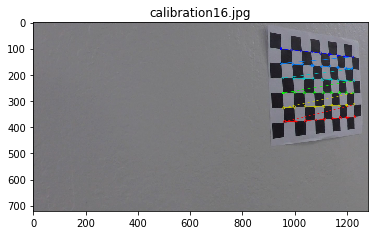

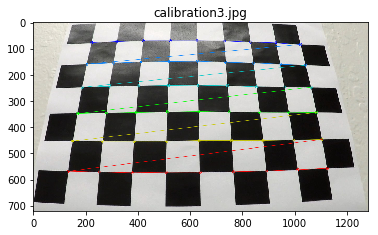

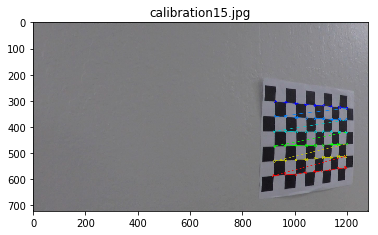

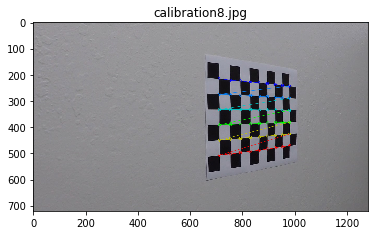

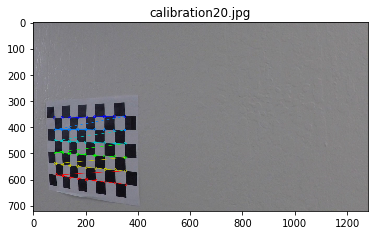

...

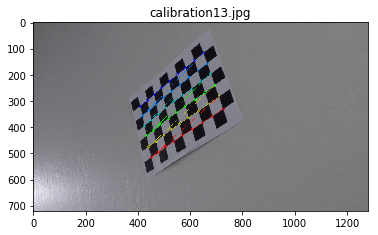

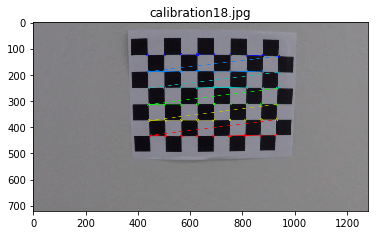

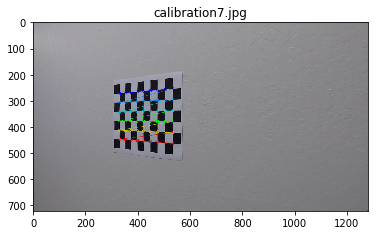

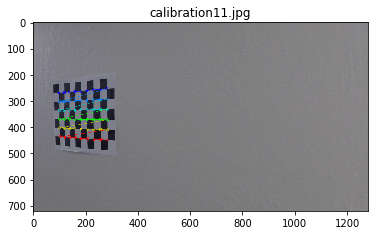

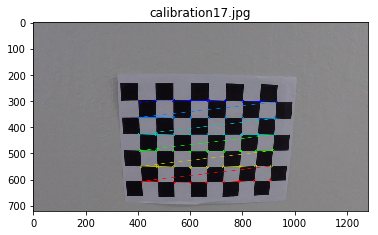

In [3]:
# Camera Calibration matrix & Distortion co-efficients
mtx, dist = calibrate_camera(input_dir='camera_cal/', output_dir='output_images/', nx=9, ny=6)

In [4]:
# save calibration output as pickle
calibration_output = {'mtx': mtx, 'dist': dist}
with open('camera_cal/calibration_output.p', 'wb') as output_file:
    pickle.dump(calibration_output, output_file)

---

### Distortion Correction

In [5]:
# Load the camera calibration pickle
def load_calibration_pickle():
    
    with open('camera_cal/calibration_output.p', 'rb') as input_file:
        calibration_output = pickle.load(input_file)

    mtx, dist = calibration_output['mtx'], calibration_output['dist']
    
    return mtx, dist

In [6]:
mtx, dist = load_calibration_pickle()

In [7]:
def correct_distortion(fname, output_dir='output_images/'):
    img = cv2.imread(fname)
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=25)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image', fontsize=25)
    plt.show()
    
    # save output image
    img_name=fname.split('/')[1]
    cv2.imwrite(output_dir+'/'+'undist_'+img_name, cv2.cvtColor(undistorted, cv2.COLOR_RGB2BGR))
    
    return undistorted
                

**Test chessboard images used for camera calibration**

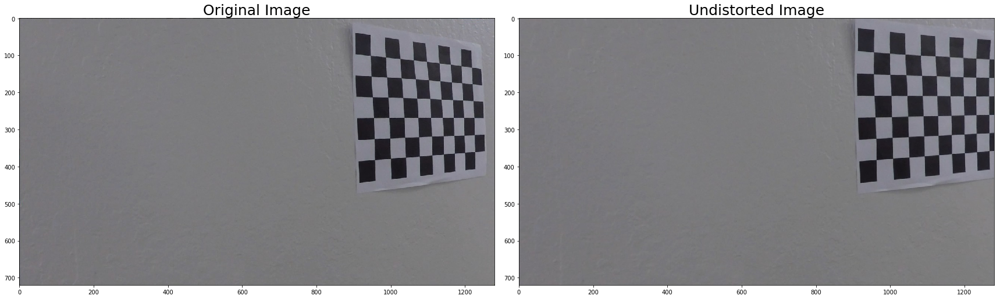

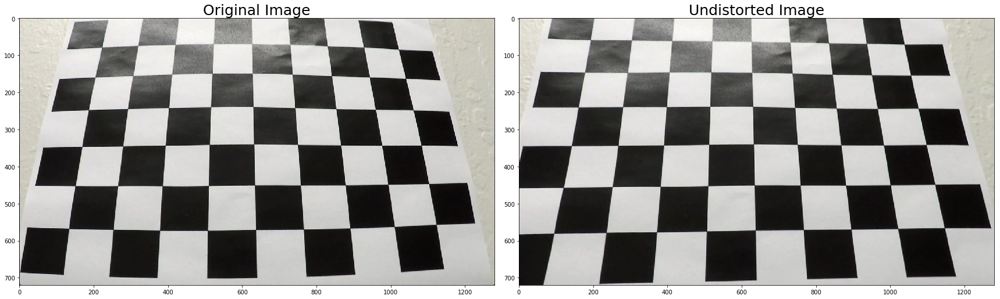

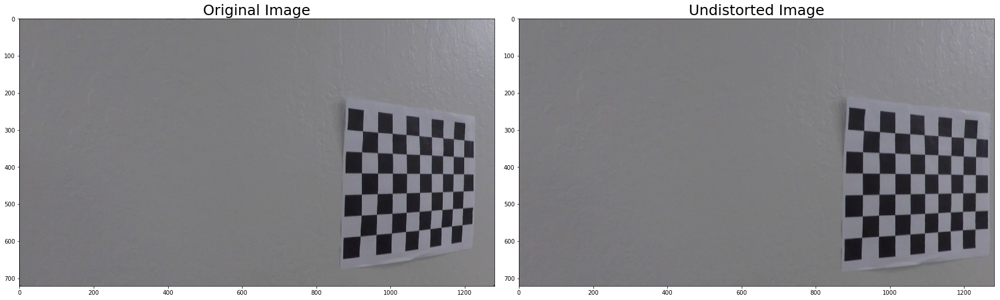

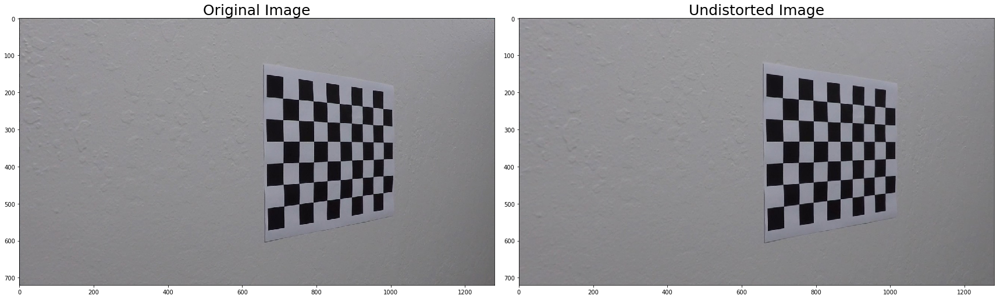

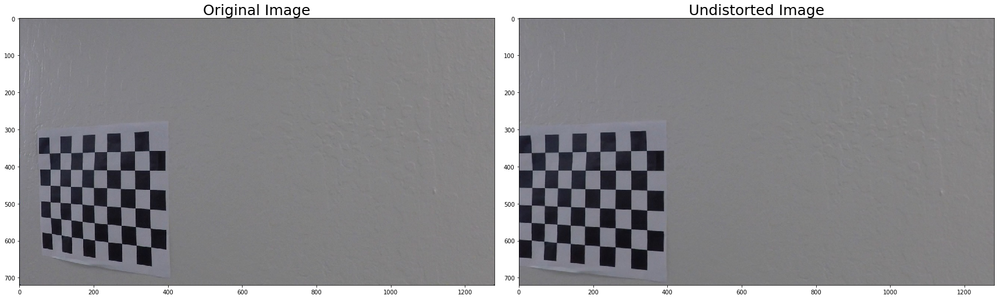

...

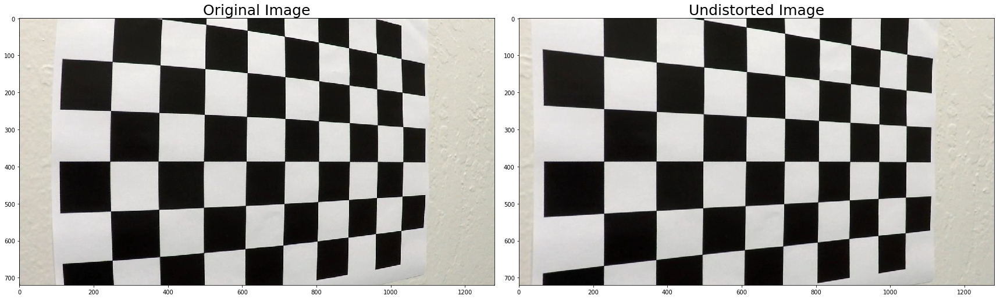

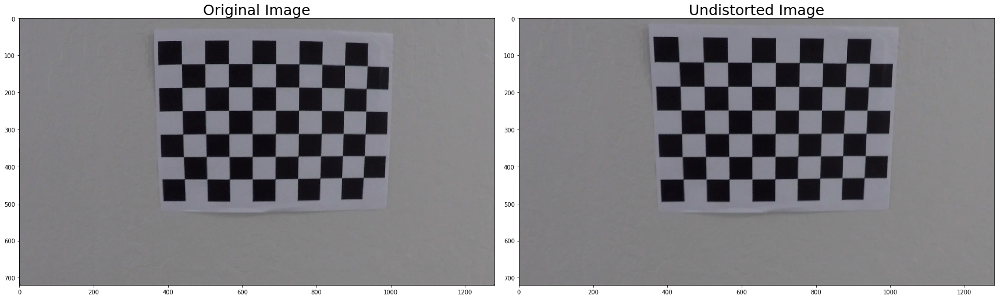

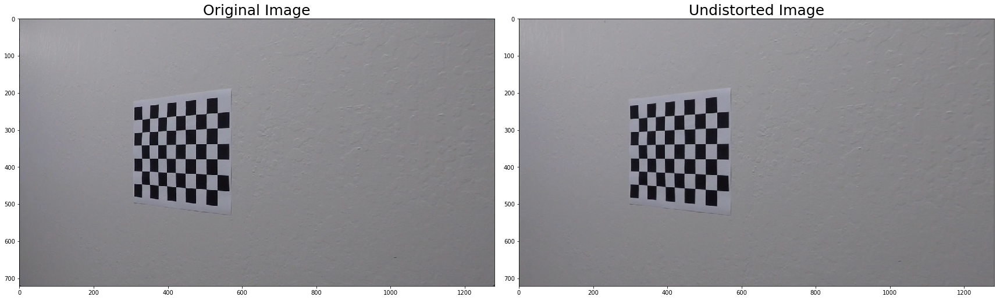

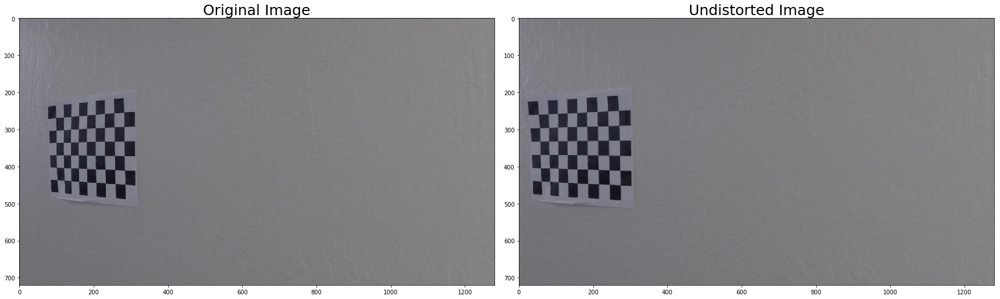

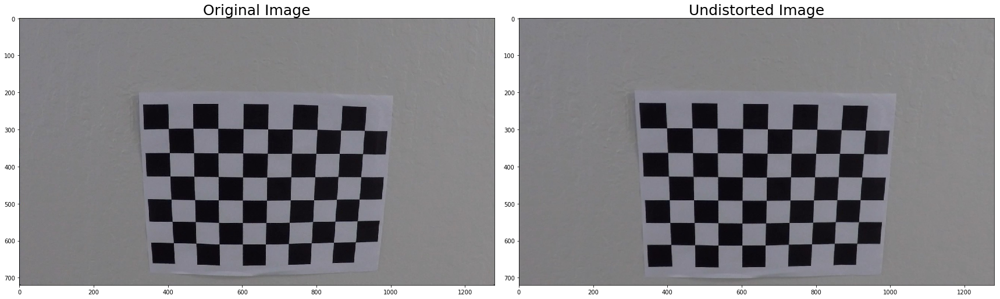

In [8]:
# read images in calibration directory
input_dir='camera_cal/'
images = glob.glob(input_dir+'calibration*.jpg')
for fname in images:
    _ = correct_distortion(fname, output_dir='output_images/')

**Distortion Correction on Test images**

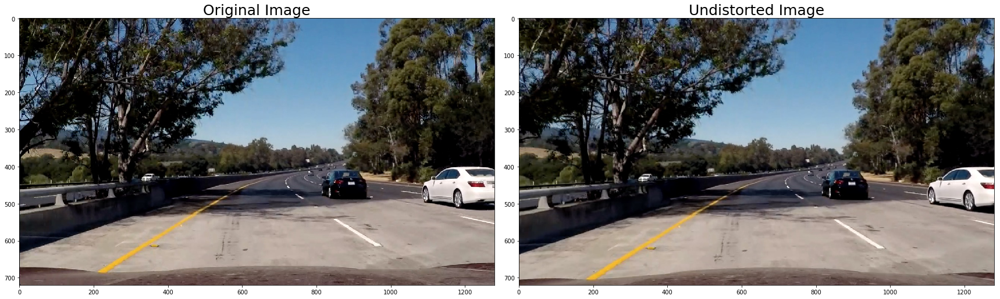

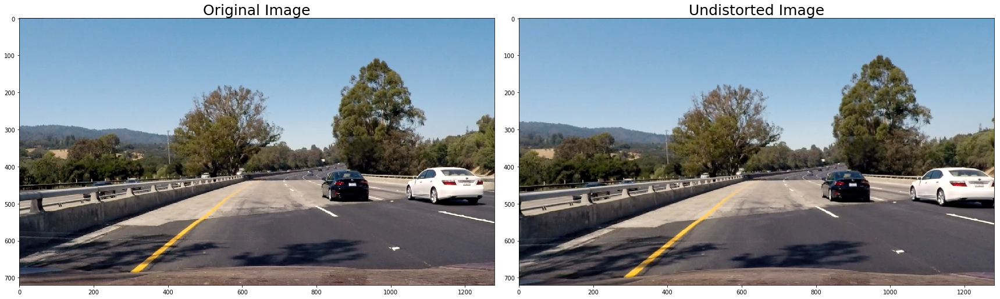

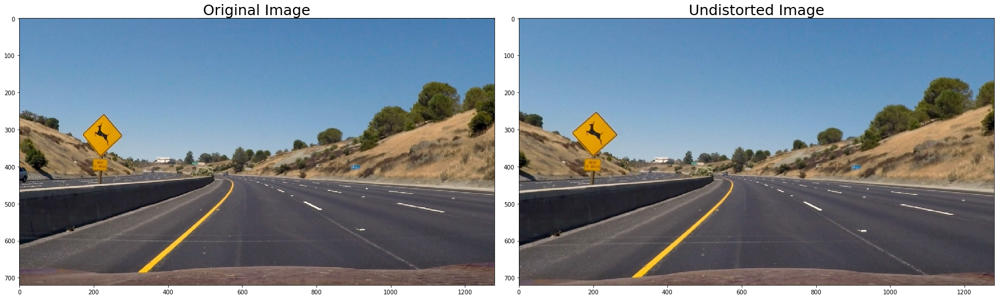

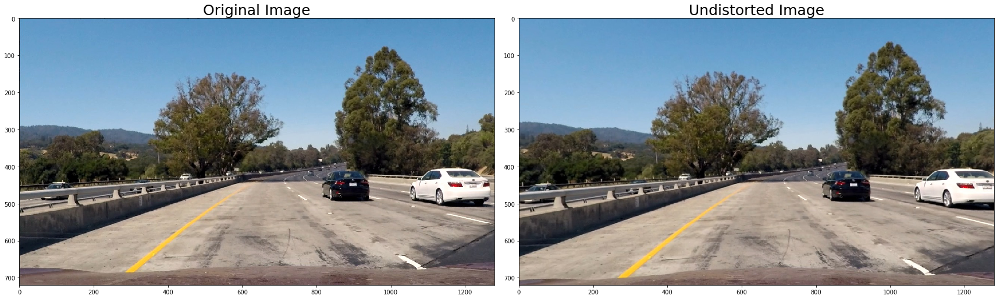

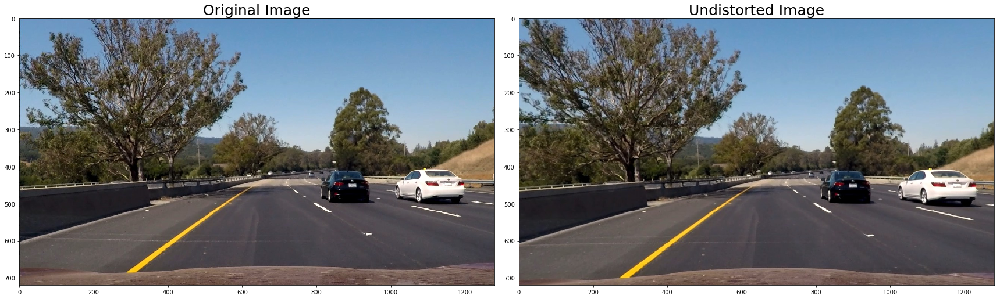

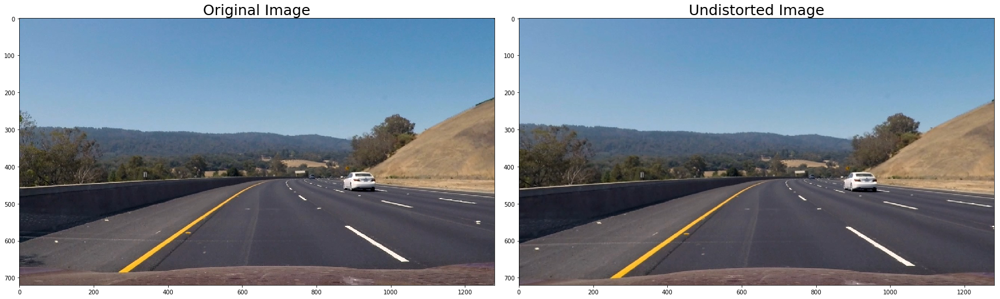

In [9]:
# read images in test directory
input_dir='test_images/'
images = glob.glob(input_dir+'test*.jpg')
for fname in images:
    _ = correct_distortion(fname, output_dir='output_images/')

---

### Perspective Warping

In [10]:
def warp(fname, mtx, dist, output_dir='output_images/'):
    
    img = mpimg.imread(fname)
    imshape = img.shape
    x_mid = imshape[1] // 2
    y_mid = imshape[0] // 2

    # undistort image
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    
    # convert to grayscale
    gray = cv2.cvtColor(undist, cv2.COLOR_BGR2GRAY)
    
    
    # calibration box in source coordinates
    src = np.float32([[x_mid+90, y_mid+120], 
                     [imshape[1]-180,imshape[0]], 
                     [300, imshape[0]],
                     [x_mid-60, y_mid+120]])
    
    # destination coordinates
    dst = np.float32([[imshape[1]-180, 0], 
                      [imshape[1]-180, imshape[0]],
                      [300, imshape[0]],
                      [300, 0]])

    # perspective transform M
    M = cv2.getPerspectiveTransform(src, dst)
    
    # Inverse perspective transform Minv
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # warped image
    warped = cv2.warpPerspective(img, M, (imshape[1], imshape[0]), flags=cv2.INTER_LINEAR)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=25)
    ax2.imshow(warped)
    ax2.set_title('Warped Image', fontsize=25)
    plt.show()
    
    # save output image
    img_name=fname.split('/')[1]
    cv2.imwrite(output_dir+'/'+'warped_'+img_name, cv2.cvtColor(warped, cv2.COLOR_RGB2BGR))

**Perspective Transform on Test Images**

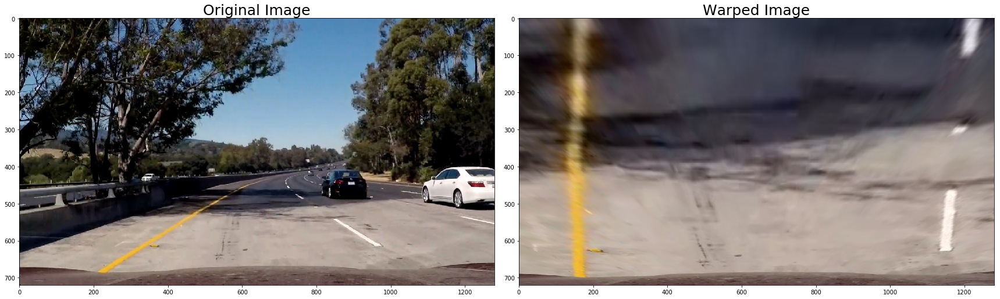

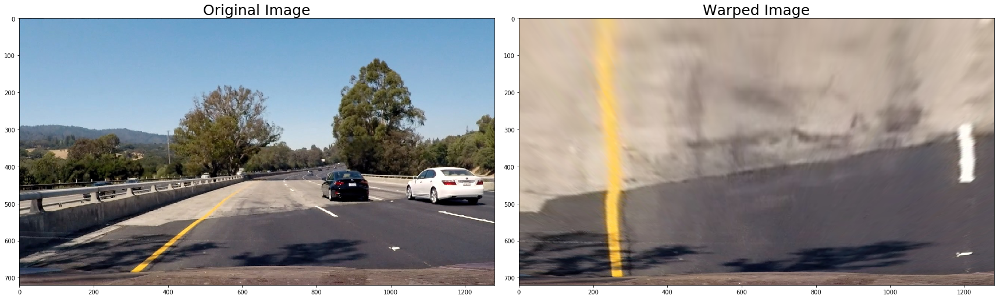

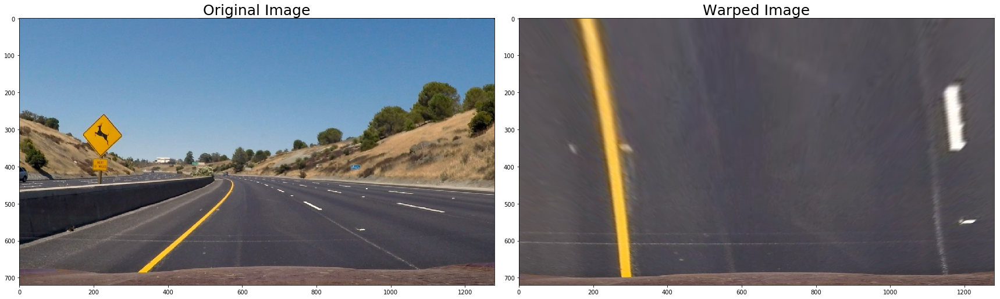

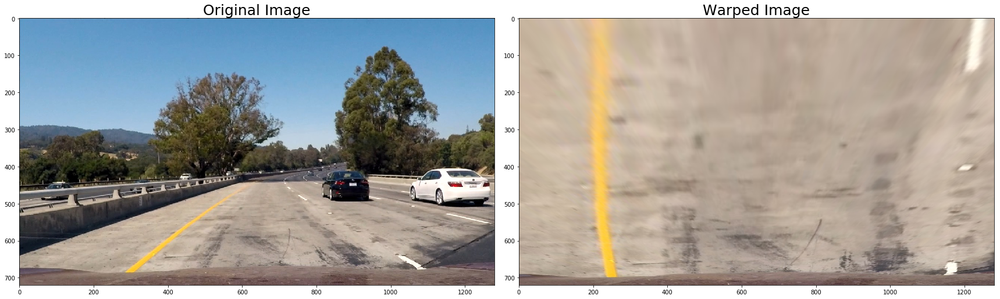

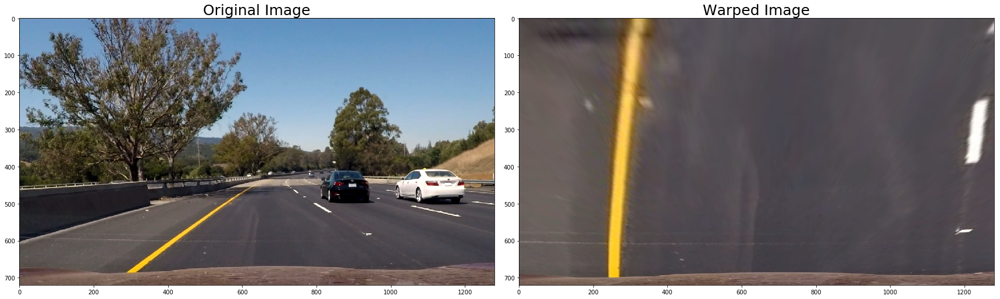

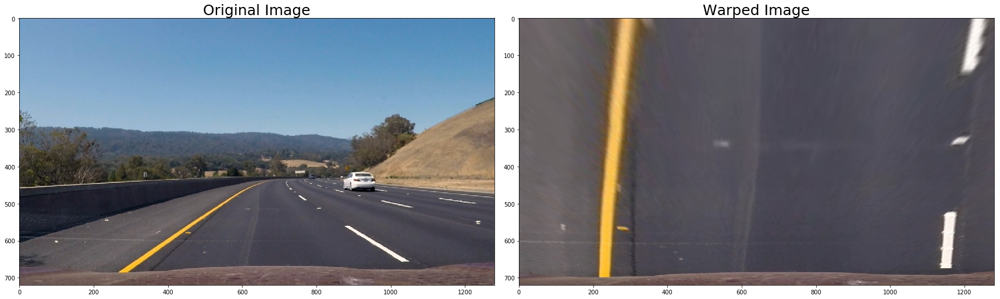

In [11]:
# load calibration output 
mtx, dist = load_calibration_pickle()

# read images in test directory
input_dir='test_images/'
images = glob.glob(input_dir+'test*.jpg')
for fname in images:
    warp(fname, mtx, dist, output_dir='output_images/')

---

### Thresholding

Create a thresholded binary image using color transforms and gradients.

In [12]:
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Absolute value of x or y gradient
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Return the result
    return binary_output

In [13]:
def apply_thresholding(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    
    img = np.copy(img)
    
    # Threshold x gradient
    (thresh_min, thresh_max) = sx_thresh
    
    sx_binary = abs_sobel_thresh(img, orient='x', thresh_min=thresh_min, thresh_max=thresh_max)  
    
    # Threshold color channel
    
    # Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # Stack each channel
    # color_binary = np.dstack(( np.zeros_like(sx_binary), sx_binary, s_binary)) * 255
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sx_binary)
    combined_binary[(s_binary == 1) | (sx_binary == 1)] = 1
    
    # Morphological operation to 'fill gaps' in detected regions
    kernel = np.ones((5, 5), np.uint8)
    closed_binary = cv2.morphologyEx(combined_binary.astype(np.uint8), cv2.MORPH_CLOSE, kernel)
    
    return closed_binary


**Apply thresholding on Test images**

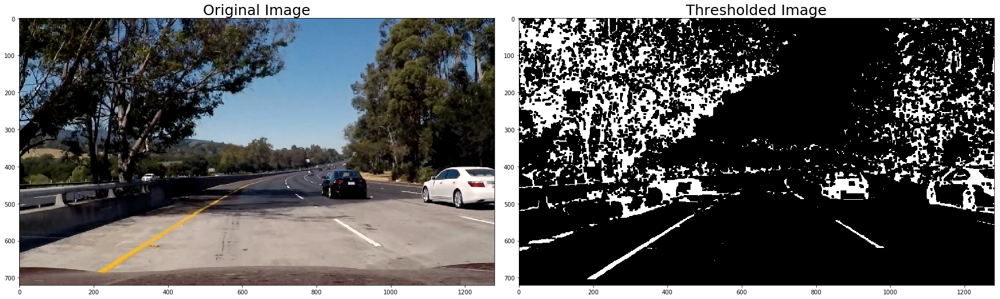

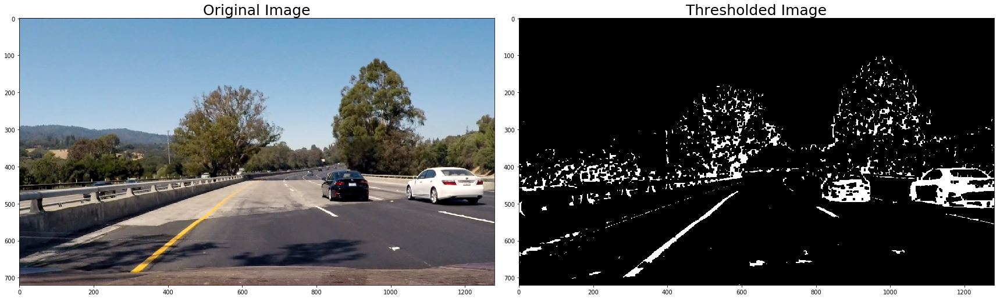

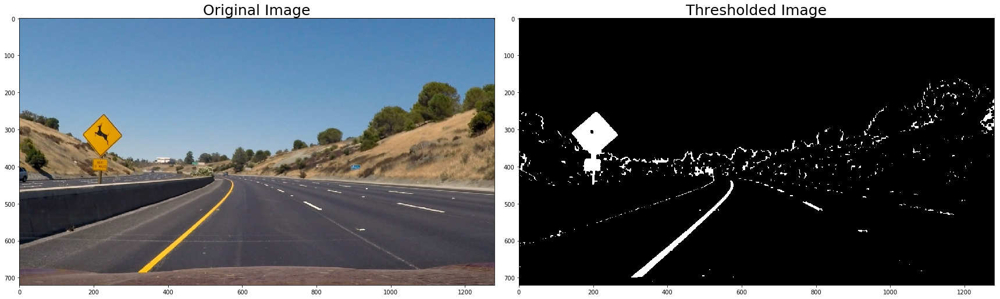

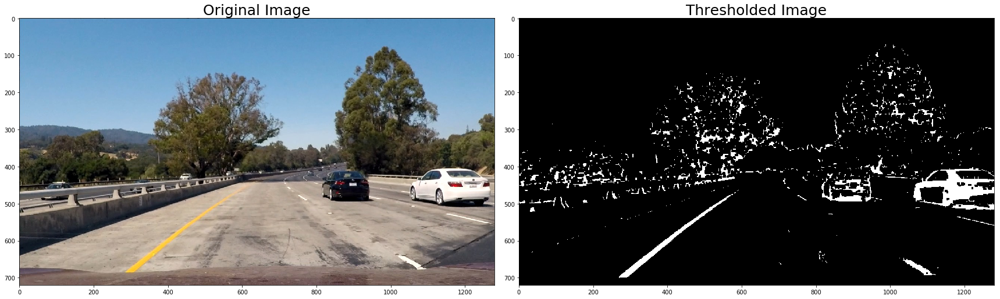

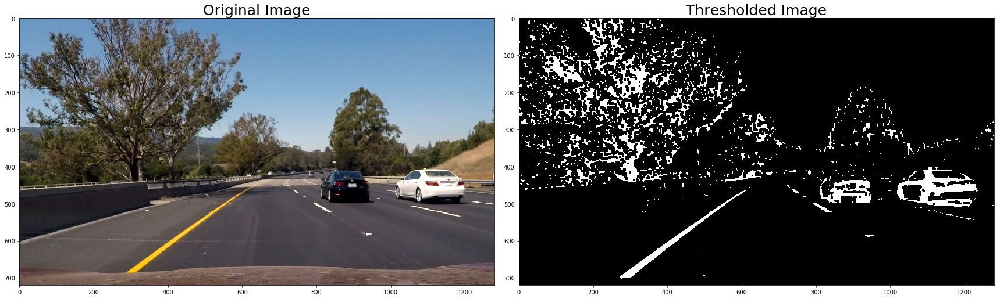

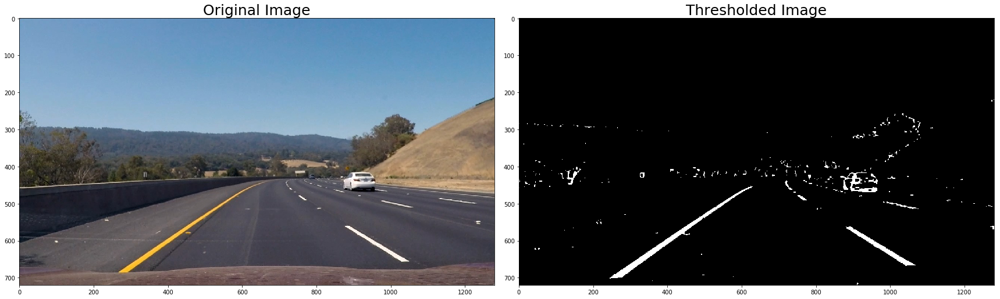

In [14]:
# load calibration output 
mtx, dist = load_calibration_pickle()

# read images in test directory
input_dir='test_images/'
output_dir='output_images/'
images = glob.glob(input_dir+'test*.jpg')
for fname in images:
    img = mpimg.imread(fname)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    thresholded = apply_thresholding(undist, s_thresh=(160, 255), sx_thresh=(50, 100))
  
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=25)
    ax2.imshow(thresholded, cmap='gray')
    ax2.set_title('Thresholded Image', fontsize=25)
    plt.show()
    
    # save output image
    img_name=fname.split('/')[1]
    cv2.imwrite(output_dir+'thresh_'+img_name, cv2.cvtColor(thresholded, cv2.COLOR_GRAY2BGR))

**Apply Perspective Warp on thresholded images**

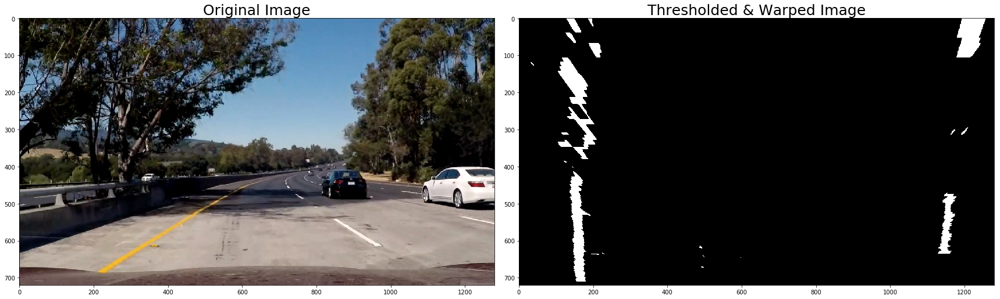

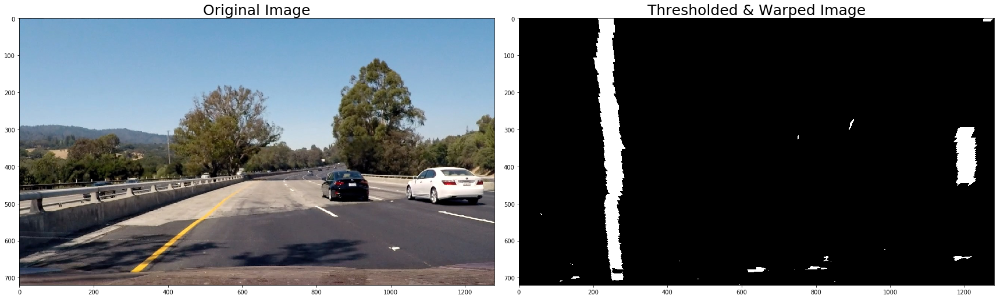

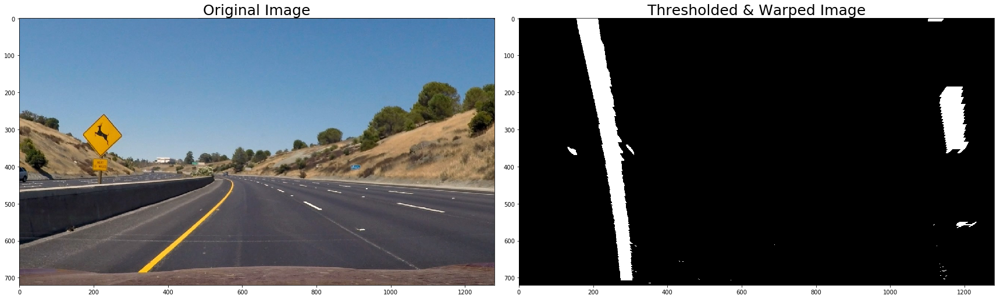

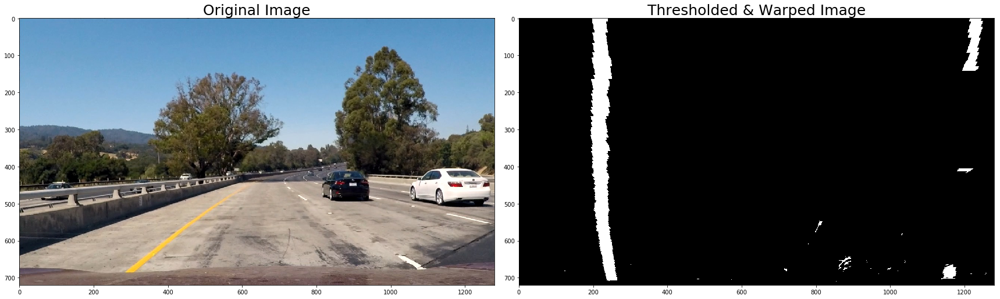

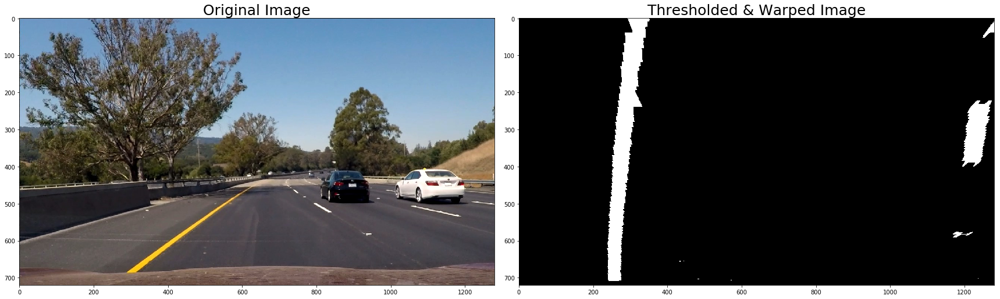

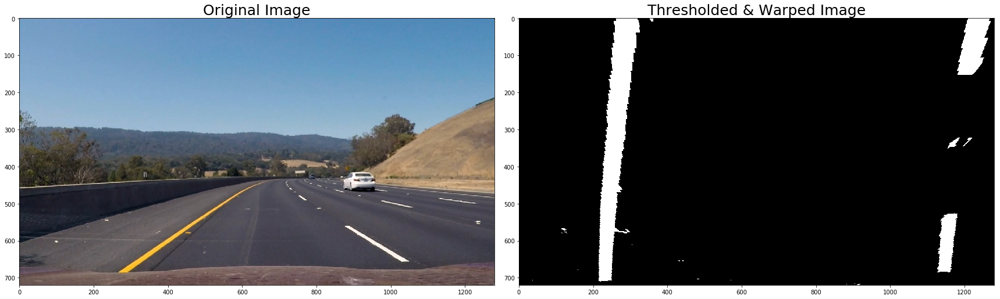

In [15]:
# load calibration output 
mtx, dist = load_calibration_pickle()

# read images in test directory
input_dir='test_images/'
output_dir='output_images/'
images = glob.glob(input_dir+'test*.jpg')
for fname in images:
    img = mpimg.imread(fname)
    imshape = img.shape
    x_mid = imshape[1] // 2
    y_mid = imshape[0] // 2
    
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    thresholded = apply_thresholding(undist, s_thresh=(160, 255), sx_thresh=(40, 100))
    

    # calibration box in source coordinates
    src = np.float32([[x_mid+90, y_mid+120], 
                     [imshape[1]-180,imshape[0]], 
                     [300, imshape[0]],
                     [x_mid-60, y_mid+120]])
    
    # destination coordinates
    dst = np.float32([[imshape[1]-180, 0], 
                      [imshape[1]-180, imshape[0]],
                      [300, imshape[0]],
                      [300, 0]])

    # perspective transform M
    M = cv2.getPerspectiveTransform(src, dst)
    
    # Inverse perspective transform Minv
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # warped image
    warped = cv2.warpPerspective(thresholded, M, (imshape[1], imshape[0]), flags=cv2.INTER_LINEAR)
  
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=25)
    ax2.imshow(warped, cmap='gray')
    ax2.set_title('Thresholded & Warped Image', fontsize=25)
    plt.show()
    
    # save output image
    img_name=fname.split('/')[1]
    cv2.imwrite(output_dir+'thresh_warped_'+img_name, cv2.cvtColor(warped, cv2.COLOR_GRAY2BGR))

In [16]:
img = mpimg.imread(input_dir+'test1.jpg')
imshape = img.shape
x_mid = imshape[1] // 2
y_mid = imshape[0] // 2
    

# calibration box in source coordinates
src = np.float32([[x_mid+90, y_mid+120], 
                     [imshape[1]-180,imshape[0]], 
                     [300, imshape[0]],
                     [x_mid-60, y_mid+120]])
    
# destination coordinates
dst = np.float32([[imshape[1]-180, 0], 
                      [imshape[1]-180, imshape[0]],
                      [300, imshape[0]],
                      [300, 0]])

print('xmid:', x_mid, 'ymid:', y_mid)
print('Source Points:', src)
print('Destination Points:', dst)

xmid: 640 ymid: 360
Source Points: [[  730.   480.]
 [ 1100.   720.]
 [  300.   720.]
 [  580.   480.]]
Destination Points: [[ 1100.     0.]
 [ 1100.   720.]
 [  300.   720.]
 [  300.     0.]]


---

### Finding Lanes

In [17]:
# find lines using sliding window approach
def search_sliding_window(binary_warped, n_windows=9):
    
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[(binary_warped.shape[0]//2)-25:,:], axis=0)
    
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    
    # Find the peak of the left and right halves of the histogram
    # i.e starting point for the left and right lines    
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Set the width of the windows +/- margin
    margin = 100
    
    # Set the height of windows
    window_height = np.int(binary_warped.shape[0]//n_windows)
    
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzero_y = np.array(nonzero[0])
    nonzero_x = np.array(nonzero[1])
    
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to store left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(n_windows):
        
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        
        # four below boundaries of the window
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        
        # nonzero pixels in x and y within the window
        good_left_inds = ((nonzero_y >= win_y_low) & (nonzero_y < win_y_high) & (nonzero_x >= win_xleft_low) & (nonzero_x < win_xleft_high)).nonzero()[0]
        
        good_right_inds = ((nonzero_y >= win_y_low) & (nonzero_y < win_y_high) & (nonzero_x >= win_xright_low) & (nonzero_x < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window
        # (`right` or `leftx_current`) on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzero_x[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzero_x[good_right_inds]))

    # Concatenate the arrays of indices
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        pass

    # Extract left and right line pixel positions
    leftx = nonzero_x[left_lane_inds]
    lefty = nonzero_y[left_lane_inds] 
    rightx = nonzero_x[right_lane_inds]
    righty = nonzero_y[right_lane_inds] 
    return leftx, lefty, rightx, righty, out_img

In [18]:
# fit a second degree polynomial

def fit_poly(img_shape, leftx, lefty, rightx, righty, lefty_ext, righty_ext):
    
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Calculate polynomials
    left_fitx = left_fit[0]*lefty_ext**2 + left_fit[1]*lefty_ext + left_fit[2]
    right_fitx = right_fit[0]*righty_ext**2 + right_fit[1]*righty_ext + right_fit[2]
    
    return left_fitx, right_fitx

In [19]:
# Conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meteres per pixel in x dimension

def find_lane_lines(binary_warped, undist, undist_warped):
    imshape = binary_warped.shape
        
    # slinding window approach
    leftx, lefty, rightx, righty, out_img = search_sliding_window(binary_warped)      
    
    lefty_ext = np.append(lefty, 0)
    lefty_ext = np.append(imshape[0], lefty_ext)
    
    righty_ext = np.append(righty, 0)
    righty_ext = np.append(imshape[0], righty_ext)
        
    left_fitx, right_fitx = fit_poly(imshape, leftx, lefty, rightx, righty, lefty_ext, righty_ext)
        
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, lefty_ext]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, righty_ext])))])
    
    pts = np.hstack((pts_left, pts_right))
    
    leftx_meter, lefty_meter = leftx*xm_per_pix, lefty*ym_per_pix
    rightx_meter, righty_meter = rightx*xm_per_pix, righty*ym_per_pix
        
    left_poly_cr = np.polyfit(lefty_meter, leftx_meter, 2)
    right_poly_cr = np.polyfit(righty_meter, rightx_meter, 2)
    
    y_eval = 580*ym_per_pix
    
    # calculate curvature of lane lines
    left_curvature = ((1+(2*left_poly_cr[0]*y_eval)+left_poly_cr[1])**2)**1.5 / np.abs(2*left_poly_cr[0])
    right_curvature = ((1+(2*right_poly_cr[0]*y_eval)+right_poly_cr[1])**2)**1.5 / np.abs(2*right_poly_cr[0])
        
    lane_center = left_fitx[0] + (right_fitx[0]-left_fitx[0])/2.0
    offset = (lane_center-imshape[1]/2) * xm_per_pix
    
    # Create an output image to draw on and visualize the result
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    warp_out = np.dstack((warp_zero, warp_zero, warp_zero))
        
    # draw lane on the blank image
    cv2.fillPoly(warp_out, np.int_([pts]), (0,255,0))
        
    # unwarp blank image to original image space
    unwarped = cv2.warpPerspective(warp_out, Minv, (imshape[1], imshape[0]))
        
    # add lane on to original image
    out_img = cv2.addWeighted(undist, 1, unwarped, 0.3, 0)
        
    # add text
    cv2.putText(out_img, 'Curvature of left lane: %d m' % left_curvature,
                   (50,50), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255), 3)
    cv2.putText(out_img, 'Curvature of right lane: %d m' % right_curvature,
                   (50,100), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255), 3)
    cv2.putText(out_img, 'Offset: %0.2f m' % abs(offset),
                   (50,150), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255), 3)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    ax1.imshow(undist_warped)
    ax1.scatter(leftx, lefty, c = 'b')
    ax1.scatter(rightx, righty, c = 'b')
    ax1.plot(left_fitx, lefty_ext, color='green', linewidth=3)
    ax1.plot(right_fitx, righty_ext, color='green', linewidth=3)
    ax1.set_xlim([0, 1280])
    ax1.set_ylim([0, 720])
    ax2.imshow(out_img)
    plt.show()

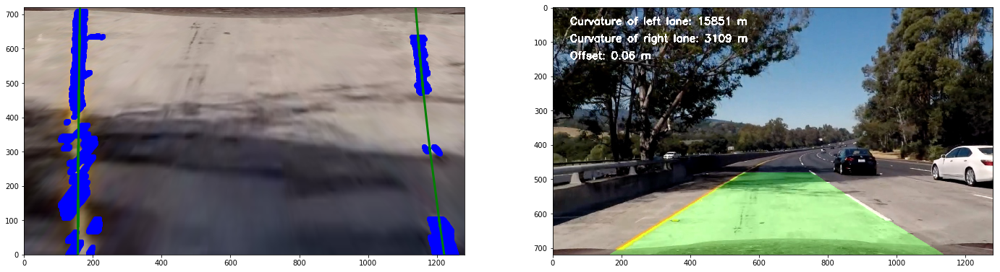

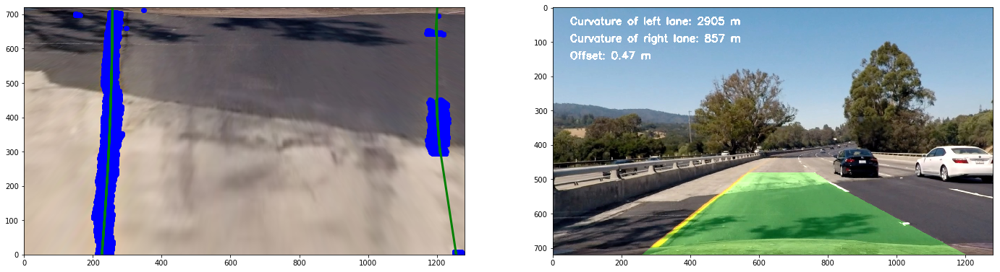

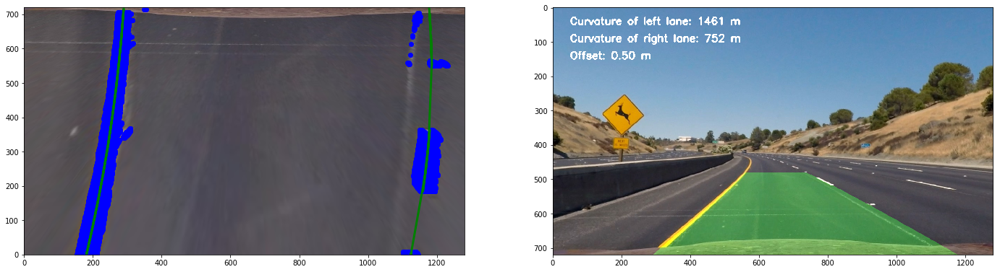

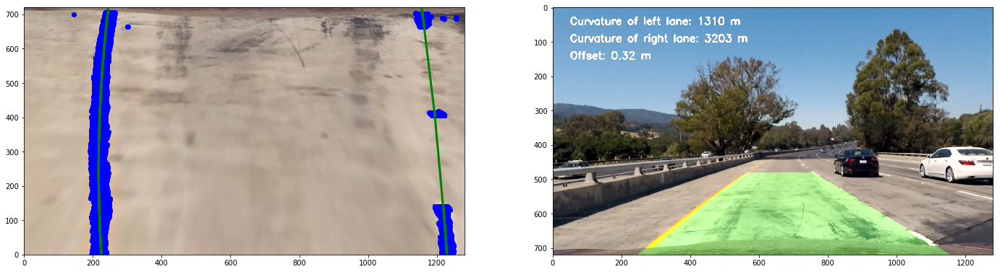

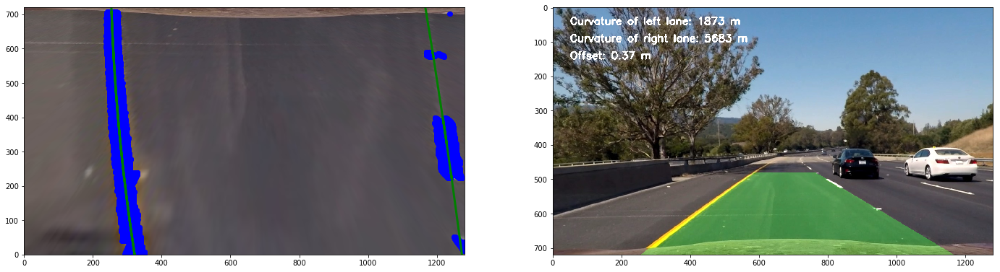

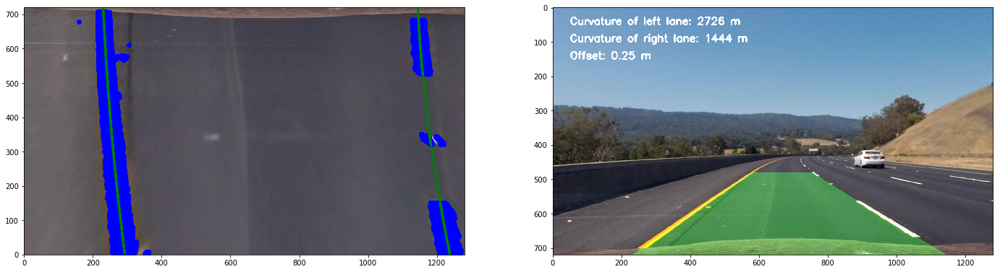

In [20]:
# load calibration output 
mtx, dist = load_calibration_pickle()

# read images in test directory
input_dir='test_images/'
output_dir='output_images/'
images = glob.glob(input_dir+'test*.jpg')
for fname in images:
    img = mpimg.imread(fname)
    imshape = img.shape
    x_mid = imshape[1] // 2
    y_mid = imshape[0] // 2
    
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    thresholded = apply_thresholding(undist, s_thresh=(160, 255), sx_thresh=(40, 100))
    
    # calibration box in source coordinates
    src = np.float32([[x_mid+90, y_mid+120], 
                     [imshape[1]-180,imshape[0]], 
                     [300, imshape[0]],
                     [x_mid-60, y_mid+120]])
    
    # destination coordinates
    dst = np.float32([[imshape[1]-180, 0], 
                      [imshape[1]-180, imshape[0]],
                      [300, imshape[0]],
                      [300, 0]])


    # perspective transform M
    M = cv2.getPerspectiveTransform(src, dst)
    
    # Inverse perspective transform Minv
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # warped image
    binary_warped = cv2.warpPerspective(thresholded, M, (imshape[1], imshape[0]), flags=cv2.INTER_LINEAR)
    
    # undist warped
    undist_warped = cv2.warpPerspective(undist, M, (imshape[1], imshape[0]), flags=cv2.INTER_LINEAR)
    
    find_lane_lines(binary_warped, undist, undist_warped)

---

### Lane Detection Pipeline

In [21]:
# Conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meteres per pixel in x dimension

# class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        
        self.left_points = None
        self.right_points = None
        
        # radius of curvature of the line
        self.left_curvature = 1000
        self.right_curvature = 1000
        
        # list of polynomial coefficients of the last N iterations
        self.recent_fits_left = collections.deque(maxlen=10)
        self.recent_fits_right = collections.deque(maxlen=10)
        
    def get_average_fit(self):
        average_left_fit = np.mean(self.recent_fits_left, axis=0) if len(self.recent_fits_left) == 10 else None
        average_right_fit = np.mean(self.recent_fits_right, axis=0) if len(self.recent_fits_right) == 10 else None
        return average_left_fit, average_right_fit
    
    # fit a second degree polynomial
    def fit_poly(self, img_shape, leftx, lefty, rightx, righty, lefty_ext, righty_ext):
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
        
        self.recent_fits_left.append(left_fit)
        self.recent_fits_right.append(right_fit)
        
        average_left_fit, average_right_fit = self.get_average_fit()
        
        # Calculate polynomials
        if average_left_fit is not None:
            left_fitx = average_left_fit[0]*lefty_ext**2 + average_left_fit[1]*lefty_ext + average_left_fit[2]
        else:
            left_fitx = left_fit[0]*lefty_ext**2 + left_fit[1]*lefty_ext + left_fit[2]
            
        # Calculate polynomials
        if average_right_fit is not None:
            right_fitx = average_right_fit[0]*righty_ext**2 + average_right_fit[1]*righty_ext + average_right_fit[2]
        else:
            right_fitx = right_fit[0]*righty_ext**2 + right_fit[1]*righty_ext + right_fit[2]
    
        return left_fitx, right_fitx
    
    # find lane lines
    def find_lane_lines(self, binary_warped):
        
        imshape = binary_warped.shape
        
        # slinding window approach
        leftx, lefty, rightx, righty, out_img = search_sliding_window(binary_warped)
        
        lefty_ext = np.append(lefty, 0)
        lefty_ext = np.append(imshape[0], lefty_ext)
    
        righty_ext = np.append(righty, 0)
        righty_ext = np.append(imshape[0], righty_ext)
        
        left_fitx, right_fitx = self.fit_poly(imshape, leftx, lefty, rightx, righty, lefty_ext, righty_ext)            
        
        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, lefty_ext]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, righty_ext])))])
        
        # sanity check lane width
        if (right_fitx[0] - left_fitx[0]) < 850:
            pts_left = self.left_points
            pts_right = self.right_points
        
        leftx_meter, lefty_meter = leftx*xm_per_pix, lefty*ym_per_pix
        rightx_meter, righty_meter = rightx*xm_per_pix, righty*ym_per_pix
        
        left_poly_cr = np.polyfit(lefty_meter, leftx_meter, 2)
        right_poly_cr = np.polyfit(righty_meter, rightx_meter, 2)
        
        y_eval = 580*ym_per_pix
        
        left_curvature = ((1+(2*left_poly_cr[0]*y_eval)+left_poly_cr[1])**2)**1.5 / np.abs(2*left_poly_cr[0])
        right_curvature = ((1+(2*right_poly_cr[0]*y_eval)+right_poly_cr[1])**2)**1.5 / np.abs(2*right_poly_cr[0])
        
        # sanity check
        if left_curvature < 3000:
            self.left_points = pts_left
            self.left_curvature = left_curvature
        else:            
            pts_left = self.left_points
            left_curvature = self.left_curvature
        
        if right_curvature < 3000:
            self.right_points = pts_right
            self.right_curvature = right_curvature
        else:            
            pts_right = self.right_points
            right_curvature = self.right_curvature
            
            
        pts = np.hstack((pts_left, pts_right))
        
        lane_center = left_fitx[0] + (right_fitx[0]-left_fitx[0])/2.0
        offset = (lane_center-imshape[1]/2) * xm_per_pix
        
        return pts, left_curvature, right_curvature, offset
    
    def draw_lanes(self, binary_warped, undist, pts, left_curvature, right_curvature, offset, Minv):
        imshape = img.shape
        # Create an output image to draw on and visualize the result
        warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
        warp_out = np.dstack((warp_zero, warp_zero, warp_zero))
        
        # draw lane on the blank image
        cv2.fillPoly(warp_out, np.int_([pts]), (0,255,0))
        
        # unwarp blank image to original image space
        unwarped = cv2.warpPerspective(warp_out, Minv, (imshape[1], imshape[0]))
        
        # add lane on to original image
        out_img = cv2.addWeighted(undist, 1, unwarped, 0.3, 0)
        
        # add text
        cv2.putText(out_img, 'Curvature of left lane: %d m' % left_curvature,
                   (50,50), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255), 3)
        cv2.putText(out_img, 'Curvature of right lane: %d m' % right_curvature,
                   (50,100), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255), 3)
        cv2.putText(out_img, 'Offset: %0.2f m' % abs(offset),
                   (50,150), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255), 3)
        
        return out_img
    
    def lane_detection_pipeline(self, img):
        # load calibration output 
        mtx, dist = load_calibration_pickle()
        mshape = img.shape
        x_mid = imshape[1] // 2
        y_mid = imshape[0] // 2
    
        undist = cv2.undistort(img, mtx, dist, None, mtx)
        thresholded = apply_thresholding(undist, s_thresh=(160, 255), sx_thresh=(40, 100))
        
        # calibration box in source coordinates
        src = np.float32([[x_mid+90, y_mid+120], 
                     [imshape[1]-180,imshape[0]], 
                     [300, imshape[0]],
                     [x_mid-60, y_mid+120]])
    
        # destination coordinates
        dst = np.float32([[imshape[1]-180, 0], 
                      [imshape[1]-180, imshape[0]],
                      [300, imshape[0]],
                      [300, 0]])


        # perspective transform M
        M = cv2.getPerspectiveTransform(src, dst)
    
        # Inverse perspective transform Minv
        Minv = cv2.getPerspectiveTransform(dst, src)
    
        # warped image
        binary_warped = cv2.warpPerspective(thresholded, M, (imshape[1], imshape[0]), flags=cv2.INTER_LINEAR)
    
        # undist warped
        undist_warped = cv2.warpPerspective(undist, M, (imshape[1], imshape[0]), flags=cv2.INTER_LINEAR)
    
        pts, left_curvature, right_curvature, offset = self.find_lane_lines(binary_warped)
        
        out_img = self.draw_lanes(binary_warped, undist, pts, left_curvature, right_curvature, offset, Minv)      
        
        return out_img

In [22]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [23]:
project_output = 'output_images/project_video_output.mp4'
line = Line()
clip1 = VideoFileClip("project_video.mp4")
project_clip = clip1.fl_image(line.lane_detection_pipeline)
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video output_images/project_video_output.mp4
[MoviePy] Writing video output_images/project_video_output.mp4


100%|█████████▉| 1260/1261 [05:50<00:00,  3.54it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_images/project_video_output.mp4 

CPU times: user 3min 34s, sys: 2.59 s, total: 3min 36s
Wall time: 5min 53s


In [24]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))

**Link to Output Video**  
https://youtu.be/PAP6v4AD330

---